In [2]:
#import some libraries
import nltk
from pprint import pprint
import csv
from typing import List
import re
from collections import Counter
import numpy as np
import pandas as pd
from IPython.display import clear_output
import pickle
from sklearn.externals import joblib

# from sklearn import model_selection, preprocessing, linear_model, naive_bayes, metrics, svm
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn import decomposition, ensemble, cluster
from sklearn.decomposition import PCA
from sklearn.externals import joblib

# import pandas, xgboost, numpy, textblob, string
# from keras.preprocessing import text, sequence
# from keras import layers, models, optimizers

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
# from sklearn.model_selection import train_test_split
# from sklearn.feature_selection import mutual_info_regression, mutual_info_classif

In [10]:
def simple_tokenizer(text: str) -> List[str]:
    # Looking at the text we see that <br></br> which is HTML tag for line break can be a good splitter
    # A sentence (atleast well structured) often has a full spot at the end. We use these two for word breaks
    pattern1 = re.compile("<br /><br />|\.")
    lines = re.split(pattern1, text)
    # you can break a sentence into words using whitespace based split
    tokens = []
    for line in lines:
        tokens += line.split(" ")

    # lowercase and remove any non-alphanumeric characters from tokens for normalize
    norrmalized_tokens = [re.sub(r"\W+", "", token.lower()) for token in tokens]
    return norrmalized_tokens


In [11]:
#remove stop-words
from nltk.corpus import stopwords # library 
nltk.download('stopwords')
all_stopwords = set(stopwords.words('english')) # set the language 

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\nagem\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [15]:
#load datset
df = pd.read_csv('C:/Users/nagem/OneDrive/Documents/MSBA 2019/570/clash_of_clans_570/clash-of-clans.csv')
df.head()


,Date,Content,Name,Rating
0,2/1/2019,💜💜💜,Tusher shimul,5
1,2/1/2019,Pls make it th13,NaN,3
2,2/1/2019,it is cute,jibon ahmed,5
3,2/1/2019,superb,Sunil Jayasingha,5
4,2/1/2019,"its an awesome game, period",NaN,5


In [16]:
#look for null values in Content column
df[(df['Content']).isnull()] 

,Date,Content,Name,Rating
37400,11/13/2018,NaN,Jessie Mark Eliseo,4


In [17]:
#row 598 in different language remove row
#37400 = nan
rows_to_remove = [598, 37400]
print(len(df))
df.drop(index=rows_to_remove, inplace=True)
print(len(df))

50001
49999


In [18]:
#load content into separate df
content = df.Content

#look at first 5 rows of content
ctr = 0
for row in content:
    if ctr > 5:
        break
    print(row)
    ctr+=1

💜💜💜
Pls make it th13
it is cute
superb
its an awesome game, period
wow


In [19]:
#  Tokenize each review using simple tokenizer
#  like before and remove stopwords
reviews_list = []
# with open("clash-of-clans.csv", newline="") as csvfile:
#     movie_data = csv.reader(csvfile, delimiter=",")
x=0
for row in content:
    #print current line to determine row if error occurs
    # clear_output(wait=True)
    x+=1
    # print(x)
    
    review_text = row
    # print(row)
    tokens = simple_tokenizer(review_text)
    # Remove stopwords
    clean_tokens = []
    for tokens in tokens:
        if tokens not in all_stopwords and len(tokens) > 1:
            clean_tokens.append(tokens)
    
    reviews_list.append(clean_tokens)


In [20]:
# the end result is a map with key as review_id and value as review
pprint('number of reviews:' + str(len(reviews_list)))
pprint('sample row:')
print(reviews_list[1])

'number of reviews:49999'
'sample row:'
['pls', 'make', 'th13']


In [21]:
# Identify unique tokens count their term frequency in each review and document frequency
tf_dict = {}  # data structure to hold term frequencies in each reviews
df_dict = (
    Counter()
)  # data structure to hold document frequency. You can read more about 'Counters' here: https://docs.python.org/3.1/library/collections.html
# token_counter=0
for review_id, review_tokens in enumerate(reviews_list):
    tf_dict[review_id] = Counter()
    for token in review_tokens:
        if token not in df_dict:
            df_dict[token] = 1
        if token in tf_dict[review_id]:
            tf_dict[review_id][token] += 1
        else:
            tf_dict[review_id][token] = 1
            df_dict[token] += 1


In [22]:
pprint("number of unique tokens: " + str(len(df_dict)))

'number of unique tokens: 17647'


(0.0, 80.0)

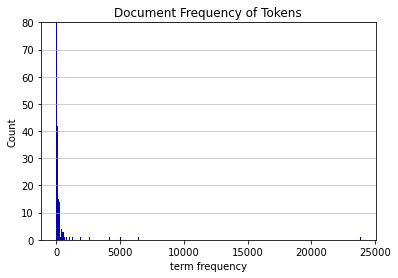

In [15]:

# since the numberof unqiue words is too high. We plot histogram to see extremly common
# or extremely rare tokens
import matplotlib.pyplot as plt


n, bins, patches = plt.hist(x=list(df_dict.values()), bins=1000, color="#0504aa")
plt.grid(axis="y", alpha=0.75)
plt.xlabel("term frequency")
plt.ylabel("Count")
plt.title("Document Frequency of Tokens")
maxfreq = n.max()
# Set a clean upper y-axis limit.
plt.ylim(ymax=80)


In [16]:
df_dict.most_common(5)

[('game', 23853),
 ('good', 7836),
 ('nice', 6456),
 ('best', 5037),
 ('love', 4188)]

In [30]:
# save to joblib
joblib.dump(df_dict, 'df_dict_untrimmed')

['df_dict_untrimmed']

In [27]:
# uncomment to load file
# df_dict_test = joblib.load('df_dict_untrimmed')

In [229]:
# remove tokens which are extremely common or extremely rare
lower_count_thr = 100 # rare words/tokens
upper_count_thr = 800 # frequent/common tokens
trim_df_dict = Counter(
    {
        token: df_dict[token]
        for token in df_dict
        if lower_count_thr <= df_dict[token] <= upper_count_thr
    }
)
pprint("number of unique tokens after trimming: " + str(len(trim_df_dict)))
pprint("most frequent tokens")
pprint(trim_df_dict.most_common(10))
pprint("least frequent tokens")
pprint(trim_df_dict.most_common()[:-11:-1])


'number of unique tokens after trimming: 199'
'most frequent tokens'
[('one', 847),
 ('clan', 840),
 ('cool', 833),
 ('addictive', 794),
 ('really', 768),
 ('played', 758),
 ('clans', 716),
 ('make', 705),
 ('pubg', 692),
 ('get', 665)]
'least frequent tokens'
[('option', 100),
 ('done', 100),
 ('improve', 101),
 ('townhall', 101),
 ('less', 102),
 ('login', 102),
 ('banned', 102),
 ('high', 106),
 ('log', 106),
 ('everything', 107)]


In [31]:
joblib.dump(trim_df_dict, 'trim_df_dict_jl')

['trim_df_dict_jl']

In [ ]:
# joblib.load('trim_df_dict_jl')

In [32]:
# create token to id maps
token_to_id_dict = {
    token: index for index, token in enumerate(trim_df_dict)
}  # http://book.pythontips.com/en/latest/enumerate.html
id_to_token_dict = {index: token for index, token in enumerate(trim_df_dict)}
tf_idf_values = []
N = len(reviews_list)
# we are ready to compute tfidf
from math import log

#tf_idf_lists saved to pkl_file, don't need to re-run
# tf_idf_lists = []

# # ctr = 0
# for review_id, review_tokens in enumerate(reviews_list):

#     # since its not advised to hold full tf-idf dictionary due to limited  RAM, we only compute
#     # tf-idf of top 1000 reviews. IN practice the vectors are dumped to storage (a file)
#     # line by line
#     # if ctr > 10:
#     #     break
#     ctr += 1
#     tf_idf_list = [0] * len(token_to_id_dict)
#     for token in review_tokens:
#         if token not in token_to_id_dict:
#             continue
#         token_id = token_to_id_dict[token]
#         # TFIDF formula
#         if token not in tf_dict[review_id]:
#             continue
#         tf = tf_dict[review_id][token]
#         idf = log(N / df_dict[token], 10)  # log to base 10
#         tf_idf = tf * idf
#         tf_idf_list[token_id] = tf_idf
#         tf_idf_values.append(tf_idf)
#     tf_idf_lists.append(tf_idf_list)
#     with open('test.pkl', 'wb') as pkl_file:
#         pickle.dump(tf_idf_lists, pkl_file) 


In [34]:
test_df = open('C:/Users/nagem/OneDrive/Documents/MSBA 2019/570/clash_of_clans_570/test.pkl','rb')
test_df = pickle.load(test_df)
len(test_df)

49999

In [35]:
trim_keys = trim_df_dict.keys()

In [36]:
pkl = pd.DataFrame(test_df, columns = trim_keys)

In [37]:
pkl.head(5)

,pls,make,superb,awesome,wow,nice,long,takes,give,hard,...,full,seen,going,thats,killer,version,days,option,next,nyc
0,0.000000,0.000000,0.0000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2.400108,1.850772,0.0000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.000000,0.000000,0.0000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.000000,0.000000,2.0241,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.000000,0.000000,0.0000,1.429682,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [41]:
pkl10 = pkl[:10000]
df10 = df[:10000]

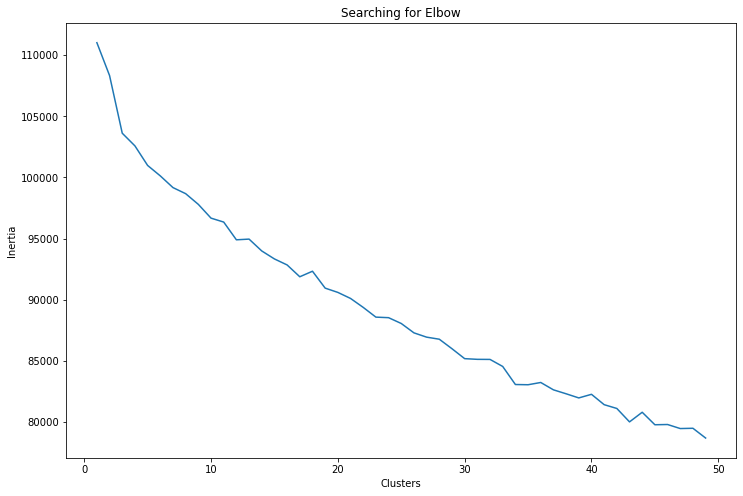

In [42]:
#Unsupervised K-means
#https://www.kaggle.com/fazilbtopal/popular-unsupervised-clustering-algorithms
from sklearn.cluster import KMeans

X=pkl10

clusters = []

for i in range(1, 50):
    km = KMeans(n_clusters=i).fit(X)
    clusters.append(km.inertia_)
    
fig, ax = plt.subplots(figsize=(12, 8))
sns.lineplot(x=list(range(1, 50)), y=clusters, ax=ax)
ax.set_title('Searching for Elbow')
ax.set_xlabel('Clusters')
ax.set_ylabel('Inertia')

# Annotate arrow
# ax.annotate('Possible Elbow Point', xy=(3, 140000), xytext=(3, 50000), xycoords='data',          
#              arrowprops=dict(arrowstyle='->', connectionstyle='arc3', color='blue', lw=2))

# ax.annotate('Possible Elbow Point', xy=(5, 80000), xytext=(5, 150000), xycoords='data',          
#              arrowprops=dict(arrowstyle='->', connectionstyle='arc3', color='blue', lw=2))

plt.show()

In [43]:
joblib.dump(km, 'km_jl')

['km_jl']

## KMeans Clustering
The figure above looks at change in inertia for 1-50 clusters. Many elbows can be observed throughout the figure. 

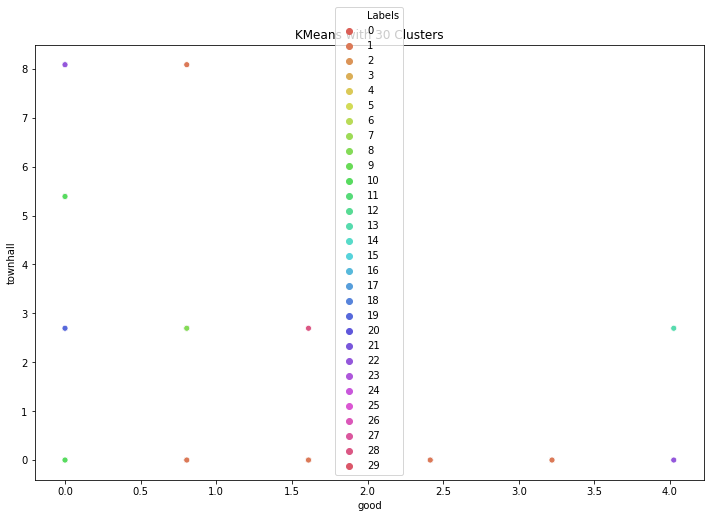

In [27]:
# 30 cluster
km30 = KMeans(n_clusters=30).fit(X)

X['Labels'] = km30.labels_
plt.figure(figsize=(12, 8))
sns.scatterplot(X['good'], X['townhall'], hue=X['Labels'], 
                palette=sns.color_palette('hls', 30))
plt.title('KMeans with 30 Clusters')
plt.show()

In [4]:
joblib.dump(km30, 'km30_joblib')


NameError: name 'km30' is not defined

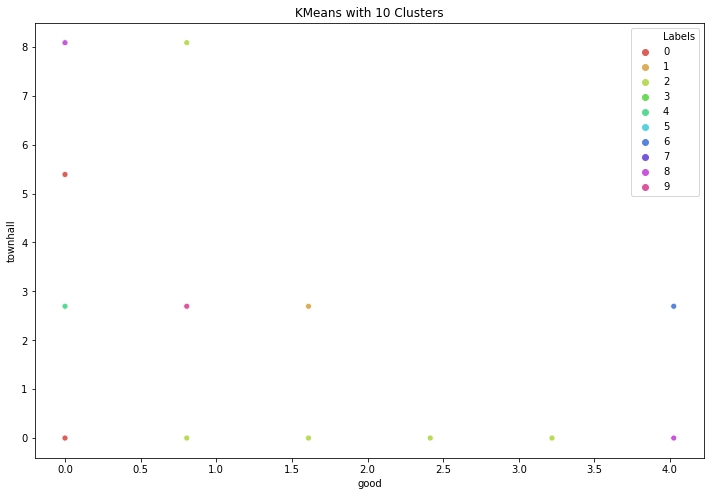

In [29]:
# 10 cluster
km10 = KMeans(n_clusters=10).fit(X)

X['Labels'] = km10.labels_
plt.figure(figsize=(12, 8))
sns.scatterplot(X['good'], X['townhall'], hue=X['Labels'], 
                palette=sns.color_palette('hls', 10))
plt.title('KMeans with 10 Clusters')
plt.show()

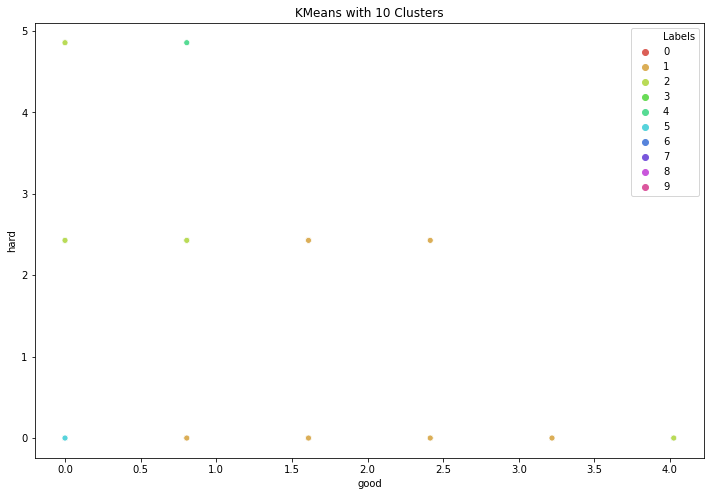

In [30]:
# 10 cluster
km10_2 = KMeans(n_clusters=10).fit(X)

X['Labels'] = km10_2.labels_
plt.figure(figsize=(12, 8))
sns.scatterplot(X['good'], X['hard'], hue=X['Labels'], 
                palette=sns.color_palette('hls', 10))
plt.title('KMeans with 10 Clusters')
plt.show()

In [56]:
#Dendrogram Associated for the Agglomerative Hierarchical Clustering
from scipy.cluster import hierarchy 
from scipy.spatial import distance_matrix 

dist = distance_matrix(X, X)
print(dist)

[[0.         3.03082123 0.         ... 0.8889978  0.         7.56635229]
 [3.03082123 0.         3.03082123 ... 3.15851142 3.03082123 8.15080145]
 [0.         3.03082123 0.         ... 0.8889978  0.         7.56635229]
 ...
 [0.8889978  3.15851142 0.8889978  ... 0.         0.8889978  7.61839905]
 [0.         3.03082123 0.         ... 0.8889978  0.         7.56635229]
 [7.56635229 8.15080145 7.56635229 ... 7.61839905 7.56635229 0.        ]]


In [94]:
from scipy.cluster.hierarchy import centroid, fcluster
from scipy.spatial.distance import pdist
y = pdist(X)
Z3 = centroid(y)
Z3.shape

(9999, 4)

In [183]:
from scipy.cluster.hierarchy import average
Z4 = hierarchy.linkage(X, method ='average', metric='cosine')
Z4.shape

(9999, 4)

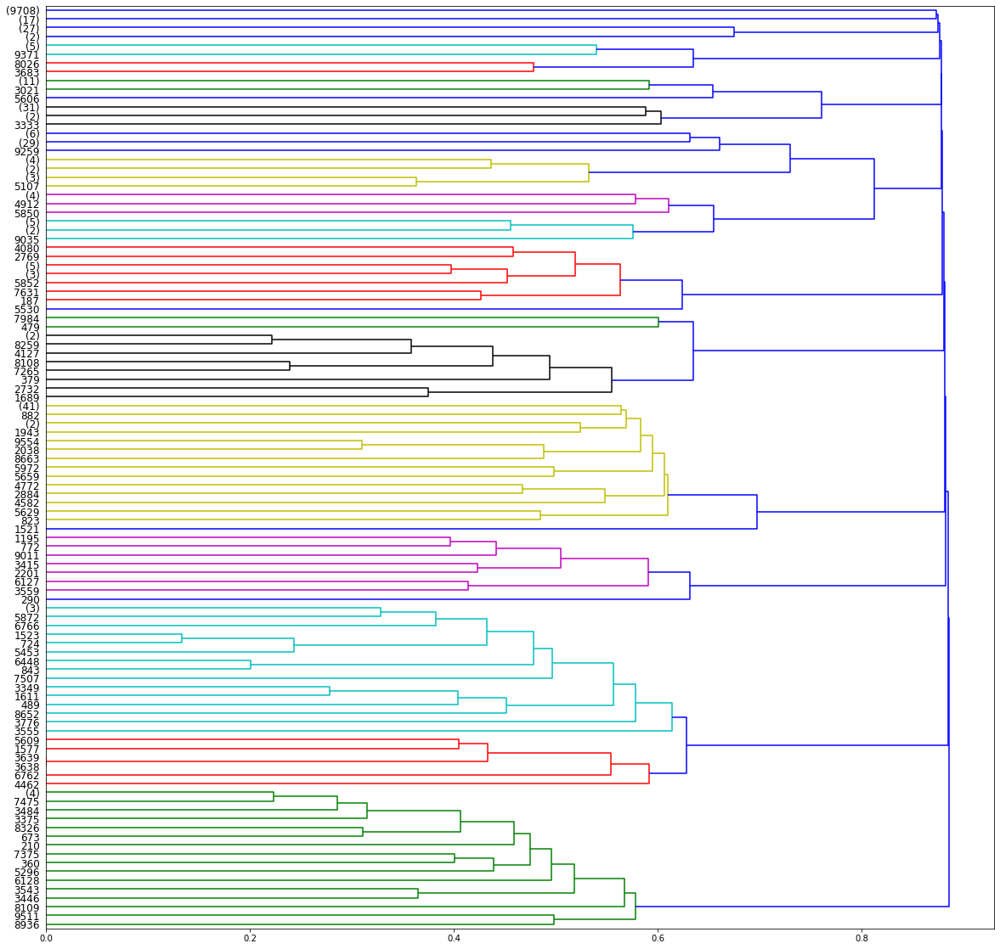

In [186]:
plt.figure(figsize=(20, 20))
dendro = hierarchy.dendrogram(Z4, leaf_rotation=0, leaf_font_size=12, orientation='right', truncate_mode='level', p=10)
plt.show()

In [195]:
dendro.keys()

dict_keys(['icoord', 'dcoord', 'ivl', 'leaves', 'color_list'])

In [222]:
fclust4 = fcluster(Z4, t=.865, criterion='distance')
print(len(np.unique(fclust4)))

pkl10['fclust4'] = fclust4

fclust_cats = np.unique(fclust4)

for x in fclust_cats:
    y = df10[df10['fclust3'] == x]
    # print(len(y))
    len_y = len(y)
    print('\nClass: {}, Count: {}'.format(x, len_y))
    if len_y >= 10:
        print(y.Content.loc[:10])
    else:
        print(y.Content)

25

Class: 1, Count: 9979
0                                                   💜💜💜
1                                      Pls make it th13
2                                            it is cute
3                                                superb
4                           its an awesome game, period
5                                                   wow
6                               Nice game and nice army
7     as long as it takes up 100 space all give it a...
8     good game in my life pubg and free fire is not...
9                                                Supper
10                          very good gamme.loving game
Name: Content, dtype: object

Class: 2, Count: 1
4832    I connect my super cell id but when I again do...
Name: Content, dtype: object

Class: 3, Count: 1
8320    Why supercell why😢😢 you, I requested you for m...
Name: Content, dtype: object

Class: 4, Count: 1
9609    Hi supercell, the new update was so awesome. T...
Name: Content, dtype: object

Class: 

In [ ]:
y_array = np.array()

In [95]:
Z3[:10]

array([[0.000e+00, 2.000e+00, 0.000e+00, 2.000e+00],
       [3.000e+00, 5.400e+01, 0.000e+00, 2.000e+00],
       [1.500e+01, 2.778e+03, 0.000e+00, 2.000e+00],
       [3.100e+01, 3.500e+01, 0.000e+00, 2.000e+00],
       [5.110e+02, 5.810e+02, 0.000e+00, 2.000e+00],
       [1.023e+03, 1.028e+03, 0.000e+00, 2.000e+00],
       [8.192e+03, 8.198e+03, 0.000e+00, 2.000e+00],
       [8.193e+03, 8.641e+03, 0.000e+00, 2.000e+00],
       [8.194e+03, 8.265e+03, 0.000e+00, 2.000e+00],
       [2.048e+03, 3.231e+03, 0.000e+00, 2.000e+00]])

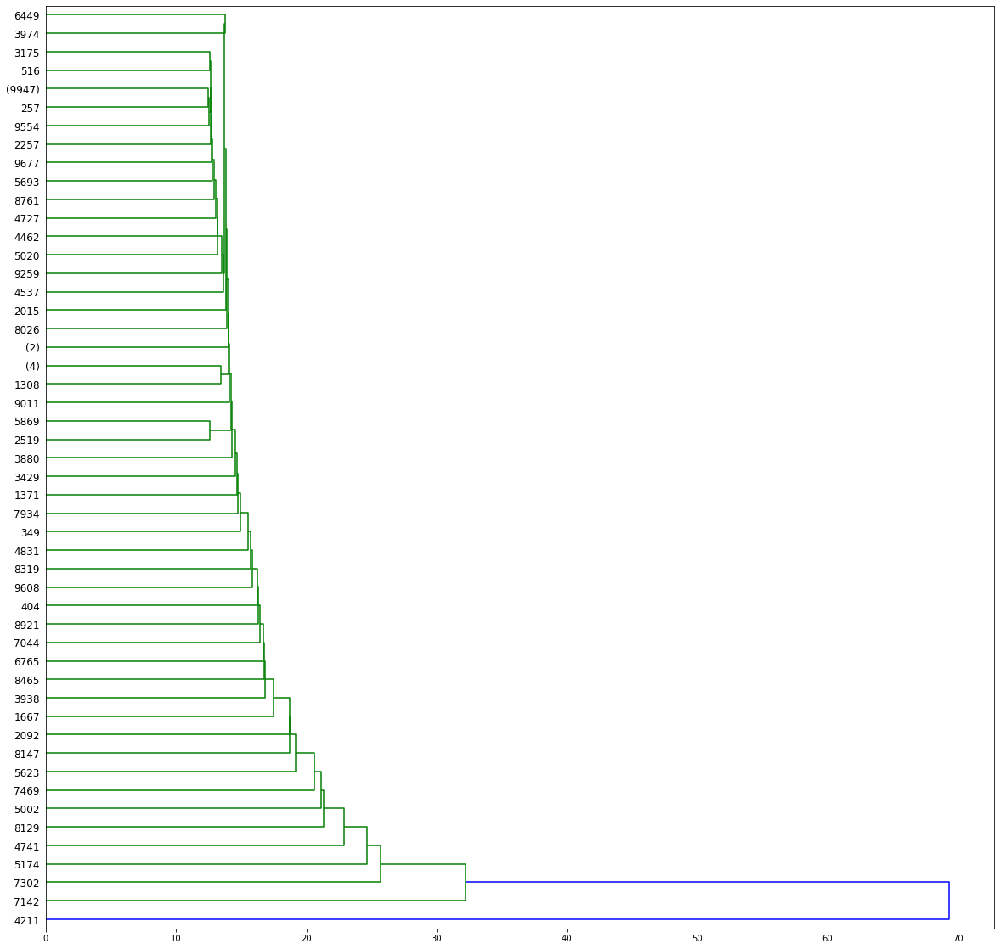

In [98]:
plt.figure(figsize=(20, 20))
dendro = hierarchy.dendrogram(Z3, leaf_rotation=0, leaf_font_size=12, orientation='right', truncate_mode='lastp', p=50)
plt.show()

In [114]:
for x in [7469, 5623,8147,2092,1667,3938,8465,6765,7044,8921,404,9608]:
    print(df.loc[x])

Date                         1/19/2019
Content    The Best Game i ever played
Name                 Manav Moorjani135
Rating                               5
Name: 7469, dtype: object
Date                       1/25/2019
Content    upgrade is very work full
Name                        arun pal
Rating                             5
Name: 5623, dtype: object
Date       1/19/2019
Content         good
Name       AHL Bro's
Rating             5
Name: 8147, dtype: object
Date         1/31/2019
Content           nice
Name       Rahul Rawat
Rating               5
Name: 2092, dtype: object
Date       2/1/2019
Content        sema
Name            NaN
Rating            5
Name: 1667, dtype: object
Date            1/26/2019
Content    very good game
Name         GAYATRI PUBG
Rating                  5
Name: 3938, dtype: object
Date                                  1/19/2019
Content    Make twon wall 13 and more than that
Name                         Shreyash Moundekar
Rating                              

In [175]:
fclust3 = fcluster(Z3, t=20, criterion='distance')
print(fclust3.shape)
print(len(np.unique(fclust3)))
fclust3


(10000,)
9


array([1, 1, 1, ..., 1, 1, 1], dtype=int32)

In [160]:
pkl10['fclust3'] = fclust3
pkl10.head(2)

df10['fclust3'] = fclust3
df10.head(2)

,Date,Content,Name,Rating,fclust3
0,2/1/2019,💜💜💜,Tusher shimul,5,1
1,2/1/2019,Pls make it th13,NaN,3,1


In [177]:
fclust_cats = np.unique(fclust3)

for x in fclust_cats:
    y = df10[df10['fclust3'] == x]
    # print(len(y))
    print('\nClass: ',x)
    len_y = len(y)
    if len_y >= 10:
        print(y.Content.loc[:10])
    else:
        print(y.Content)


Class:  1
0                                                   💜💜💜
1                                      Pls make it th13
2                                            it is cute
3                                                superb
4                           its an awesome game, period
5                                                   wow
6                               Nice game and nice army
7     as long as it takes up 100 space all give it a...
8     good game in my life pubg and free fire is not...
9                                                Supper
10                          very good gamme.loving game
Name: Content, dtype: object

Class:  2
4832    I connect my super cell id but when I again do...
Name: Content, dtype: object

Class:  3
8320    Why supercell why😢😢 you, I requested you for m...
Name: Content, dtype: object

Class:  4
9609    Hi supercell, the new update was so awesome. T...
Name: Content, dtype: object

Class:  5
404    Help my clan castle is glitched.

In [173]:
y = df10[df10['fclust3'] == 2]
len(y)

1

In [57]:
joblib.dump(dist, 'dist_jl')

['dist_jl']

In [86]:
#Use complete linkage class from hierarchy 
Z2 = hierarchy.linkage(dist, 'centroid')
joblib.dump(Z2, 'Z2_jl')

['Z2_jl']

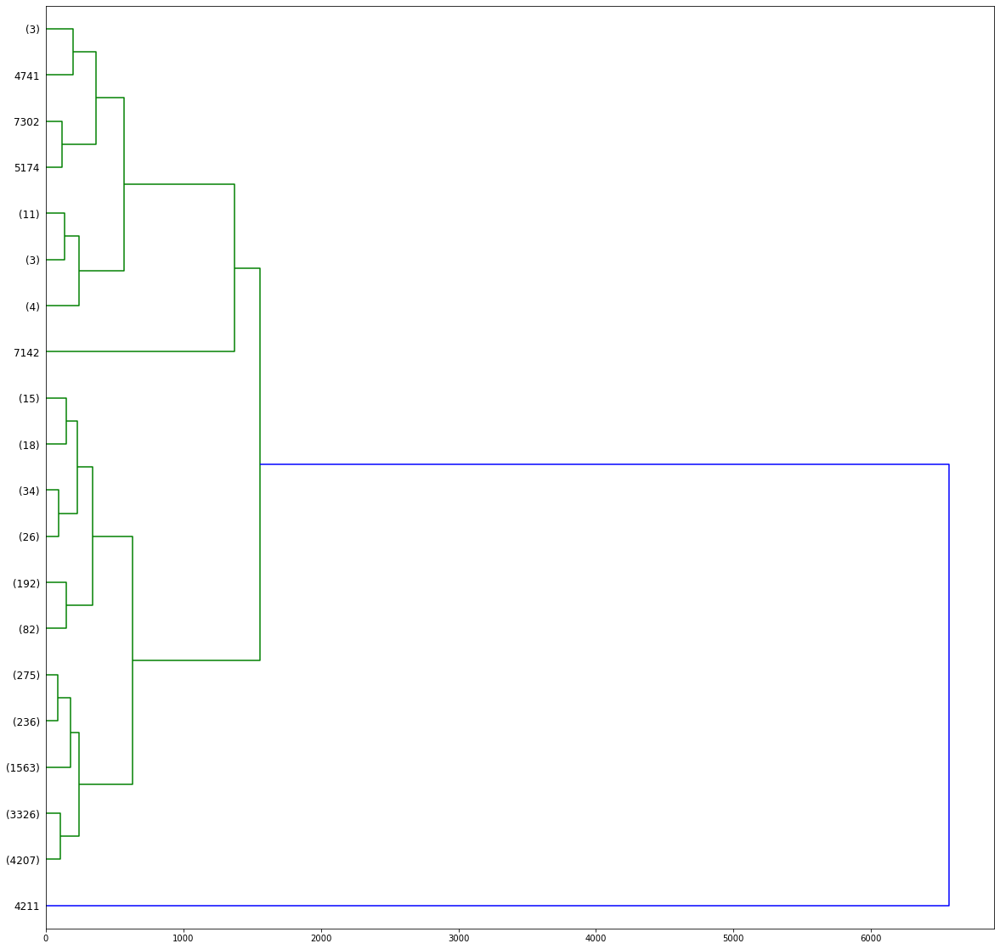

In [93]:
plt.figure(figsize=(20, 20))
dendro = hierarchy.dendrogram(Z2, leaf_rotation=0, leaf_font_size=12, orientation='right', truncate_mode='lastp', p=20)
plt.show()

In [ ]:
Z = hierarchy.linkage(dist, 'complete')
joblib.dump(Z, 'Z_jl')

['Z_jl']

In [62]:
plt.figure(figsize=(18, 50))
Z
plt.show()

<Figure size 1296x3600 with 0 Axes>

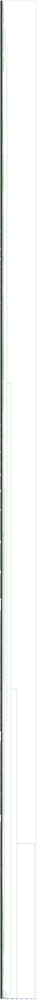

In [68]:
plt.figure(figsize=(10, 300))
dendro = hierarchy.dendrogram(Z, leaf_rotation=0, leaf_font_size=12, orientation='right',)
plt.show()

In [7]:
joblib.dump(dendro, 'dendro_j')

NameError: name 'dendro' is not defined

## PCA

In [44]:
pca=PCA(5)
pca.fit(X)
print("Principal axes:", pca.components_)
print("Explained variance:", pca.explained_variance_)
print("Mean:", pca.mean_)

Principal axes: [[ 1.34715963e-02  5.77307508e-02 -2.52158176e-03 ...  5.57127690e-03
   6.70130635e-03 -6.44711043e-04]
 [-8.54360901e-02 -9.03296907e-02  7.49855188e-03 ... -2.82265112e-02
  -2.85699872e-02  1.94576208e-03]
 [ 9.40204391e-03 -8.45122218e-02  5.50090954e-04 ...  1.07995786e-02
   4.00204901e-03  6.64343811e-04]
 [-6.90486150e-02  2.03495333e-02 -3.81761151e-03 ... -4.99626621e-03
   1.29932970e-02 -1.58571886e-03]
 [ 4.08733183e-02 -2.40018953e-02  3.34859760e-03 ...  3.93519856e-06
  -2.23792554e-02 -7.28137139e-04]]
Explained variance: [0.66735892 0.36467771 0.24607016 0.20087667 0.18418628]
Mean: [0.01728078 0.03423929 0.0182169  0.05246933 0.0197291  0.11263602
 0.01260143 0.01149967 0.03253174 0.01092204 0.01306073 0.13457374
 0.01608698 0.03197231 0.00987341 0.00874431 0.00712331 0.00669328
 0.06226458 0.02395972 0.04010434 0.07592349 0.04067809 0.0172218
 0.06271108 0.03917376 0.09197193 0.06008775 0.02675867 0.03436359
 0.01588906 0.06722995 0.03846086 0.02407

In [55]:
joblib.dump(pca, 'pca5_jl')

['pca5_jl']

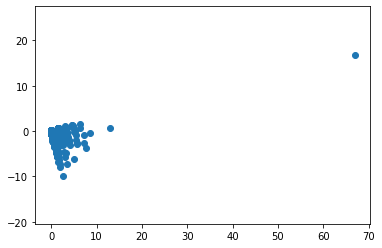

In [45]:
Z=pca.transform(X)
plt.axis('equal')
plt.scatter(Z[:,0], Z[:,1]);

(5,)

[0.66735892 0.36467771 0.24607016 0.20087667 0.18418628]


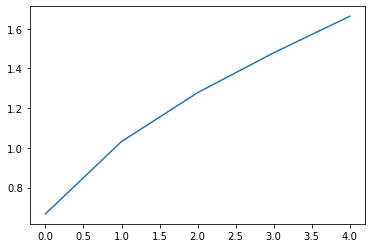

In [54]:
v=pca.explained_variance_
print(v)
plt.plot(np.arange(5,), np.cumsum(v));

In [ ]:
pca=PCA(n_components=5)
pca.fit(X)
Z=pca.transform(X)
print(pca.components_)
plt.axis('equal')
plt.scatter(Z[:,0],np.zeros(400), marker="d", alpha=0.1);

In [255]:
from sklearn.feature_extraction import grid_to_graph
connectivity = grid_to_graph(*pkl.shape)

In [261]:
foo = np.array([[1,2,3], [3,4,5]])
# print (foo.flatten(-1) == 
foo.flatten('F')#).all()
foo

array([[1, 2, 3],
       [3, 4, 5]])

In [272]:
test_array = np.array(test_df)
test_array.shape

(49999, 222)

In [287]:
X = test_array#.flatten('F')

In [289]:
X = X.reshape(1,-1)

In [290]:
X.shape

(1, 11099778)

In [286]:
# X = pkl
# connectivity = pkl.shape[0]
# X = np.array(test_df).flatten('F')
agglo = cluster.FeatureAgglomeration(connectivity=connectivity,
                                     n_clusters=20)
agglo.fit(X)
X_reduced = agglo.transform(X)

X_restored = agglo.inverse_transform(X_reduced)
images_restored = np.reshape(X_restored, images.shape)
plt.figure(1, figsize=(4, 3.5))
plt.clf()
plt.subplots_adjust(left=.01, right=.99, bottom=.01, top=.91)
for i in range(4):
    plt.subplot(3, 4, i + 1)
    plt.imshow(images[i], cmap=plt.cm.gray, vmax=16, interpolation='nearest')
    plt.xticks(())
    plt.yticks(())
    if i == 1:
        plt.title('Original data')
    plt.subplot(3, 4, 4 + i + 1)
    plt.imshow(images_restored[i], cmap=plt.cm.gray, vmax=16,
               interpolation='nearest')
    if i == 1:
        plt.title('Agglomerated data')
    plt.xticks(())
    plt.yticks(())

plt.subplot(3, 4, 10)
plt.imshow(np.reshape(agglo.labels_, images[0].shape),
           interpolation='nearest', cmap=plt.cm.nipy_spectral)
plt.xticks(())
plt.yticks(())
plt.title('Labels')
plt.show()                                    

ValueError: Found array with 1 feature(s) (shape=(11099778, 1)) while a minimum of 2 is required by FeatureAgglomeration.

In [117]:
# print sample tfidf vector values
for x in range(10):
    review_id =x
    tf_idf_vector = [tf_idf_lists[review_id][index] for index in [token_to_id_dict[token] for token in tf_dict[review_id] if token in token_to_id_dict]]
    pprint(tf_idf_vector[:10])

[]
[2.400108241949814, 1.8507722013681216]
[]
[2.024100177621709]
[1.4296819285876219]
[2.076747295393225]
[1.7779955932910132]
[2.250254998454441,
 2.3957652609390316,
 1.9136314833487533,
 2.427119711823021,
 2.3746788630618276]
[0.8048668910368219,
 2.1739165113226755,
 1.858855223902763,
 2.5316439836113442,
 2.571856519994713]
[2.638263478005909]


In [220]:
splt = 20000
tst = 30000
xtrain = df.Content[:splt]
ytrain = df.Rating[:splt]
xtest = df.Content[splt:tst]
ytest = df.Rating[splt:tst]

In [82]:
#lda 
# len(tf_idf_lists[10])
# train a LDA Model
lda_model = decomposition.LatentDirichletAllocation(n_components=20, learning_method='online', max_iter=20)
X_topics = lda_model.fit_transform(pkl10)
topic_word = lda_model.components_ 
vocab = list(trim_keys)#count_vect.get_feature_names() 

# view the topic models
n_top_words = 10
topic_summaries = []
for i, topic_dist in enumerate(topic_word):
    topic_words = np.array(vocab)[np.argsort(topic_dist)][:-(n_top_words+1):-1]
    topic_summaries.append(' '.join(topic_words))

In [84]:
# topic_word
# list(vocab)
len(np.argsort(topic_dist))

222

In [237]:
#https://jakevdp.github.io/PythonDataScienceHandbook/05.09-principal-component-analysis.html
pca = PCA(2)
projected = pca.fit_transform(pkl)
print(projected.shape)

(49999, 2)


In [9]:
joblib.dump(pca, 'pca_jl')

NameError: name 'pca' is not defined

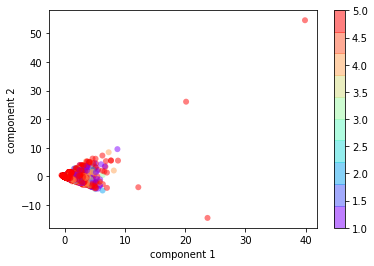

In [238]:
plt.scatter(projected[:, 0], projected[:, 1],
            c=df.Rating, edgecolor='none', alpha=0.5,
            cmap=plt.cm.get_cmap('rainbow', 10))
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.colorbar();